# ИССЛЕДОВАНИЕ ИТЕРАТИВНЫХ МЕТОДОВ ЧИСЛЕННОЙ ОПТИМИЗЦИИ

In [514]:
import plotly.graph_objects as go
import numpy as np
import time
from scipy import optimize
import random as r
import matplotlib.pyplot as plt

# Зададим функцию для отображения на графике

Зададимся границами по X и Y от 0 до 4 с шагом 0.1:

In [515]:
def function(x):
    Z = 0.5*(np.power(x[0],2)+x[0]*x[1]+np.power(x[1],2))*(
        1.+0.5*np.cos(1.5*x[0])*np.cos(3.2*x[0]*x[1])*np.cos(3.14*x[1])+
        +0.5*np.cos(2.2*x[0])*np.cos(4.8*x[0]*x[1])*np.cos(3.5*x[1]))
    return float(Z)

In [516]:
xs = np.arange(0, 4, 0.01)
ys = np.arange(0, 4, 0.01)

Определим метод для получения значения функции Z(X,Y) по аргументам X и Y:

I(x1, x2) = 0,5(x1^2 +x1*x2 + x2^2)*[1+0,5cos(1,5*x1)cos(3,2*x1*x2)cos(3,14*x2)+0,5cos(2,2*x1)cos(4,8*x1*x2)cos(3,5*x2)]

In [517]:
def XYZcreator(xs, ys):
    X, Y = np.meshgrid(xs,ys)
    Z = 0.5*(np.power(X,2)+X*Y+np.power(Y,2))*(
        1+0.5*np.cos(1.5*X)*np.cos(3.2*X*Y)*np.cos(3.14*Y)+
        +0.5*np.cos(2.2*X)*np.cos(4.8*X*Y)*np.cos(3.5*Y))
    if (type(xs)!=float and type(ys)!=float):
        if ((xs.shape == (1,) and ys.shape == (1,))):
            return Z[0]
        else:
            return X, Y, Z
    else:
        return float(Z[0])

In [518]:
X, Y, Z = XYZcreator(xs, ys)

Теперь выберем точку (X = 0, Y = 0):

Функция для построения графика:

In [519]:
def graph(func,x,y):
    x_dot = np.array([x])
    y_dot = np.array([y])
    z_dot = XYZcreator(x_dot, y_dot)
    surface = go.Surface(
        opacity=0.75,
        x=X,
        y=Y,
        z=Z,
        )
    # Блок для точки
    dot = go.Scatter3d(
        x=x_dot,
        y=y_dot,
        z=z_dot,
        mode='markers',
        marker=dict(
            size=3,
            line=dict(
                color='rgb(111, 203, 1)',
                width=1)
        )
    )

    data = [surface, dot]
    layout = go.Layout(title='My func and dot', autosize=False,
                      width=500, height=500,
                      margin=dict(l=65, r=50, b=65, t=90))
    
    fig = go.Figure(data=data, layout=layout)
    fig.show()

In [520]:
x_do = 0.
y_do = 0.

Построим поверхность двухмерной функции Z(X,Y) и отметим на ней точку Z(0,0):

In [521]:
graph(XYZcreator,x_do,y_do)

In [522]:
def order(x):    
    number = 10.
    order = 0
    T = True
    kek = x
    while(T):
        kek = kek/number
        if (kek//1>0):
            order = order + 1           
        else:
            T = False
#     print("Порядок = ",order)
    return order

In [523]:
def getStartValue(diapason):
    return int(np.random.randint(diapason[0]*1000, diapason[1]*1000, 1))/1000

In [524]:
def getRandomValue(x,alfrandom):
    randomIndex = int(np.random.randint(0, 10, 1))
    out = float(alfrandom[randomIndex])
    return out

In [525]:
def checkDiapason(z,diapasonZ,last):
    if (z < diapasonZ[1] and z > diapasonZ[0]):
        z = z
    else:
        z = last*0.8
    return z

In [526]:
alfrandom = np.array([np.random.random()*0.1 for i in range(10)])
print(alfrandom)
randomIndex = int(np.random.randint(0, 10, 1))
print(randomIndex)
print(alfrandom[randomIndex])

al = [0.01, 0.1, 0.1, 1]
len(al)

[0.09327979 0.09547833 0.03367466 0.05115816 0.02669273 0.05212619
 0.06152364 0.08989052 0.07337336 0.0244852 ]
3
0.05115815849586744


4

# Градиентный спуск

In [529]:
def gradient_low(f,diapasonx,diapazony, delta):
    ix = []
    iy = []
    it = []
    start_time_s = time.time()
    end_time_s = 0
    deltaX = delta
    deltaY = delta
    eps = delta
    t = True
    fullGrad = 999999
    gradX = 999999    
    gradY = 9999999
    i = 0
    lastx = getStartValue(diapasonx)
    lasty = getStartValue(diapazony)
    x = lastx
    y = lasty
    ix.append(x)
    iy.append(y)
    it.append(i)
#     randomIndex = int(np.random.randint(0, 10, 1))
#     alfa = alfrandom[randomIndex]
    minimial = [ 999 , "No", "No"] #f,x,y
#     print("\n"+"Start X = ",x)
#     print("Start Y = ",y)    
    number = 0
    while ((fullGrad > eps or (np.abs(gradX) > deltaX/2 and np.abs(gradY) > deltaY/2)) and end_time_s < 1.):
#         print("\n"+"Start X = ",x)
#         print("Start Y = ",y))
#         print("\nX1 = ",x)
#         print("Y1 = ",y)
        function = f(float(x), float(y))        
        if (minimial[0] > function):
            minimial[0] = function
            minimial[1] = x
            minimial[2] = y
        randomIndex = int(np.random.randint(0, 10, 1))
        alfa = alfrandom[randomIndex]
#         print("Value of Function = ",function)
        fullnextFunction = f(float(x-alfa), float(y-alfa))
#         print("Next Value of Function = ",fullnextFunction)
        nextFunctionX = f(float(x-alfa), y)    
        nextFunctionY = f(x, float(y-alfa))
        
        gradX = (nextFunctionX - function)/(-alfa)
        orderX = order(gradX)
        if (orderX > len(al)-1):
            alfaX = al[len(al)-1]*int(np.random.randint(0, 10, 1))
        else:
            alfaX = al[orderX]*int(np.random.randint(0, 10, 1))
        
        gradY = (nextFunctionY - function)/(-alfa)
        orderY = order(gradY)
        if (orderY > len(al)-1):
            alfaY = al[len(al)-1]*int(np.random.randint(0, 10, 1))
        else:
            alfaY = al[orderY]*int(np.random.randint(0, 10, 1))
#         print("Gradient X = ",gradX)
#         print("Gradient Y = ",gradY)
        fullGrad = np.sqrt(np.power(gradX,2) + np.power(gradY,2))
#         print("Gradient FULL = ",fullGrad)
#         if (fullGrad < eps or (np.abs(gradX) < deltaX/2 and np.abs(gradY) < deltaY/2)):
#             t = False
#         else:            
#             print("Number",number)        
#             print("Check",np.abs(fullnextFunction - function))

        x = float(x - alfaX*np.power(gradX,2)/gradX)
        y = float(y - alfaY*np.power(gradY,2)/gradY)
#         print("X2 = ",x)
#         print("Y2 = ",y)
#         x = checkDiapason(x,diapasonx,lastx)
#         y = checkDiapason(y,diapazony,lasty)
#         lastx = x 
#         lasy = y
        if (np.abs(fullnextFunction - function) < eps):
            number = number +1
            if (number > 35):                
                x = getStartValue(diapasonx)
                y = getStartValue(diapazony)
                x = checkDiapason(x,diapasonx,lastx)
                y = checkDiapason(y,diapazony,lasty)
#                 print("Xsss = ",x)
#                 print("Ysss = ",y)
                number = 0
        else:                
            x = float(x - (getRandomValue(x,alfrandom)*np.power(gradX,2)/gradX)/0.4)
            y = float(y - (getRandomValue(y,alfrandom)*np.power(gradY,2)/gradY)/0.4)
#             print("Xkkk = ",x)
#             print("Ykkk = ",y)
        x = checkDiapason(x,diapasonx,lastx)
        y = checkDiapason(y,diapazony,lasty)
        lastx = x 
        lasy = y
#         print("X3 = ",x)
#         print("Y3 = ",y)  
        ix.append(x)
        iy.append(y)
        i = i + 1
        it.append(i)
        end_time_s = float(time.time() - start_time_s)
    print("Min value of function = ",minimial[0])
    print("Min value of X = ",minimial[1])
    print("Min value of Y = ",minimial[2])

    lines = [ix,iy]
    lines[0],lines[1] = plt.plot(it, ix, "r",it, iy, "b")
#     plt.title('Переходная характеристика', fontsize=10)
    plt.ylabel('y,x')
    plt.xlabel("i шаг")
    plt.grid()
# plt.show()
    return minimial[0],minimial[1],minimial[2]

Min value of function =  0.002959786506945947
Min value of X =  0.03687218868461676
Min value of Y =  0.025712653273324615


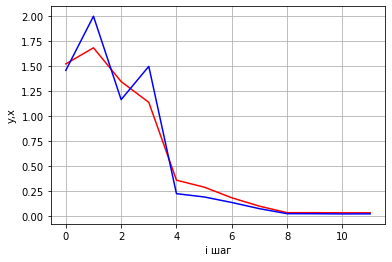

In [531]:
grad = gradient_low(XYZcreator,[0,4],[0,4], 0.01)

# x = grad[1]
# print(x)
graph(XYZcreator,grad[1],grad[2])

# Имитация отжига

In [532]:
def function(x,y):
    Z = 0.5*(np.power(x,2)+x*y+np.power(y,2))*(
        1.+0.5*np.cos(1.5*x)*np.cos(3.2*x*y)*np.cos(3.14*y)+
        +0.5*np.cos(2.2*x)*np.cos(4.8*x*y)*np.cos(3.5*y))
#     Z =  0.1*(np.power(x,2)) +  0.1*(np.power(y,2)) - 4*np.cos(0.8*x) - 4*np.cos(0.8*y) + 8
    return float(Z)

In [533]:
def getProbability(delE,T):
    return np.exp(-delE/T)

In [534]:
def simulated_annealing(start_En,start_T,min_T,diapasonx,diapazony):
    startEnergy = float(start_En)
    startTemperature = float(start_T)
    minTemperaturex = float(min_T)
    minTemperaturey = float(min_T)
    okP = 0.8 #acceptable probability
    diapasonX = diapasonx
    diapasonY = diapazony
    Temperaturex = startTemperature
    Temperaturey = startTemperature
    Energy = startEnergy
    # rang = 0
    # coef = 20
    start_time_s = time.time()
    end_time_s = 0
    x = getStartValue(diapasonX)
    y = getStartValue(diapasonY)
    lastx = x*0.88
    lasty = y*0.88
    bestStatus = [9999, x,y]
    Status = [9999, x,y]
    #20 ms for searching 
    print("\n"+"Start X = ",x)
    print("Start Y = ",y)   
    """ чем больше время, тем больше точность """
    while (Temperaturex > minTemperaturex and Temperaturey > minTemperaturey and end_time_s < 1.):
        lasty = y
        y = y - getRandomValue(y,alfrandom)*int(np.random.randint(-1, 2, 1))/0.1 
        y = checkDiapason(y,diapasonY,lasty)        
        lastx = x 
        x = x - getRandomValue(y,alfrandom)*int(np.random.randint(-1, 2, 1))/0.1 
        x = checkDiapason(x,diapasonX,lastx)
        
        Energy = function(x,y)*200
        nextEnergyx = function(x,lasty)*200
        nextEnergyy = function(lastx,y)*200
        deltaEx = nextEnergyx - Energy
        deltaEy = nextEnergyy - Energy       

#         print("\nnextEnergyx = ",nextEnergyx)
#         print("nextEnergyy = ",nextEnergyy)
#         print("energy = ",Energy)
#         print("delta Ex = ",deltaEx)
#         print("delta Ey = ",deltaEx)
#         print("X1 = ",x)
#         print("Y1 = ",y)
#         print("last x = ",lastx)
#         print("last y = ",lasty)
#         print("Tx = ",Temperaturex)
#         print("Ty = ",Temperaturey)
        if (bestStatus[0] > Status[0]):
            print(bestStatus[0])
            bestStatus[0] = Status[0]
            bestStatus[1] = Status[1]
            bestStatus[2] = Status[2]
            
        if (deltaEx >= 0):  
            P = getProbability(deltaEx,Temperaturex)
#             print("P x = ",P)
            if (P > okP):
                Status[0] = function(x,y)
                Status[1] = x
                Status[2] = y
                Temperaturex = Temperaturex*0.999   
#             else:
#                 lastx = x
#                 x = x - getRandomValue(x,alfrandom)*int(np.random.randint(-1, 2, 1))
#                 print("X2 = ",x)
#                 x = checkDiapason(x,diapasonX,lastx)
#                 print("X3 = ",x)
        else:
            Status[0] = function(x,y)
            Status[1] = x
            Status[2] = y  
#             lastx = x - int(np.random.randint(-1, 2, 1)*0.1)  
#             x = checkDiapason(x,diapasonX,lastx)
            Temperaturex = Temperaturex*0.999999
        
        if (deltaEy >= 0):  
            P = getProbability(deltaEy,Temperaturey)
#             print("P y = ",P)
            if (P > okP):
                Status[0] = function(x,y)
                Status[1] = x
                Status[2] = y
                Temperaturey = Temperaturey*0.999   
#             else:
#                 lasty = y
#                 y = y - getRandomValue(y,alfrandom)*int(np.random.randint(-1, 2, 1))
#                 print("y2 = ",y)
#                 y = checkDiapason(y,diapasonY,lasty)
#                 print("y3 = ",y)
        else:
            Status[0] = function(x,y)
            Status[1] = x
            Status[2] = y  
#             lasty = y - int(np.random.randint(-1, 2, 1)*0.1)  
#             y = checkDiapason(y,diapasonY,lasty)
            Temperaturey = Temperaturey*0.999999
            
            
        end_time_s = float(time.time() - start_time_s)
    print("Time, c = ", end_time_s)
    return bestStatus

In [535]:
ann = simulated_annealing(400,4,0.01,[0,4],[0,4])
print(ann)
graph(XYZcreator,ann[1],ann[2])


Start X =  1.907
Start Y =  0.117
9999
0.8794456656581181
0.7494110477466763
0.5159605671769104
0.21281450933695753
0.08627560801737699
0.023325689355915426
0.01104881257676027
0.010608840703300629
0.010279939202522449
0.006641366565220613
0.004413061280257613
Time, c =  0.7121250629425049
[0.0026556602283260267, 0.007054402236182256, 0.04780797831582062]


Тест имитации отжига и подбор оптимальных коэф

In [404]:
i = 0
t = True
epsss = 0.001
while (i < 1000 and t):
    a = simulated_annealing(400,4,0.1,[0,4],[0,4])
#     a = gradient_low(XYZcreator,[0,4],[0,4], 0.01)
    if (a[0] > epsss or a[1] > epsss or a[2] > epsss):
        print(a)
        print(" i = ",i)        
    i= i+1
    print("------------------------------------", i)
print("Ok")


Start X =  0.64
Start Y =  1.021
------------------------------------ 1

Start X =  2.198
Start Y =  0.641
------------------------------------ 2

Start X =  1.138
Start Y =  1.576
------------------------------------ 3

Start X =  0.095
Start Y =  2.852
[2.4684706696788067e-06, 0.0014281254999909381, 0.0002548638426299548]
 i =  3
------------------------------------ 4

Start X =  3.557
Start Y =  2.476
------------------------------------ 5

Start X =  3.872
Start Y =  2.303
[2.271411524488249e-05, 0.0037130696143608936, 0.0016611919512664925]
 i =  5
------------------------------------ 6

Start X =  0.021
Start Y =  0.018
------------------------------------ 7

Start X =  0.205
Start Y =  3.503
------------------------------------ 8

Start X =  3.774
Start Y =  1.295
------------------------------------ 9

Start X =  3.102
Start Y =  2.53
------------------------------------ 10

Start X =  2.764
Start Y =  0.125
[4.5652083523204255e-06, 0.0017048918827970846, 0.0006919743073520221

KeyboardInterrupt: 

Проверим провильность решения с помощью методов существующей библиотеки оптимизации

In [536]:
def function(X):
    Z = 0.5*(np.power(X[0],2)+X[0]*X[1]+np.power(X[1],2))*(
        1.+0.5*np.cos(1.5*X[0])*np.cos(3.2*X[0]*X[1])*np.cos(3.14*X[1])+
        +0.5*np.cos(2.2*X[0])*np.cos(4.8*X[0]*X[1])*np.cos(3.5*X[1]))
    return float(Z)

In [537]:
result = optimize.brute(function, ((0., 4.), (0., 4.))) #метод перебора
print(result) #метод перебора
print(optimize.differential_evolution(function, ((0, 4), (0, 4))))

[0. 0.]
     fun: 0.0
 message: 'Optimization terminated successfully.'
    nfev: 4623
     nit: 153
 success: True
       x: array([0., 0.])


In [538]:
a = [1,2,3]
a = tuple (a)
a

(1, 2, 3)